keras 2.0.7, TF 1.2.1

In [1]:
import numpy as np
from pydub import AudioSegment
import random
import sys
import io
import os
import glob
import IPython
%matplotlib inline
from scipy.io import wavfile
import matplotlib.pyplot as plt
import time;
time.asctime( time.localtime(time.time()) )

'Sat Aug 25 01:03:39 2018'

In [2]:
def match_target_amplitude(sound, target_dBFS):
    change_in_dBFS = target_dBFS - sound.dBFS
    return sound.apply_gain(change_in_dBFS)

In [3]:
def graph_spectrogram(wav_file):
    rate,data=wavfile.read(wav_file)
    nfft=200
    fs=8000
    noverlap=120
    nchannels=data.ndim
    if nchannels==1:
        print ("data is 1 D. expected 2D")
        return 
    elif nchannels==2:
        pxx, freqs, bins, im = plt.specgram(x=data[:,0], NFFT=nfft, Fs=fs, noverlap = noverlap)
    return pxx

In [4]:
rate_test,size_test=wavfile.read('./raw_data/negatives/1.wav')
print (rate_test)
print (size_test.shape)

44100
(15876, 2)


In [5]:
IPython.display.Audio("audio_examples/example_train.wav")

Time steps in audio recording before spectrogram (441000,)
Time steps in input after spectrogram (101, 5511)


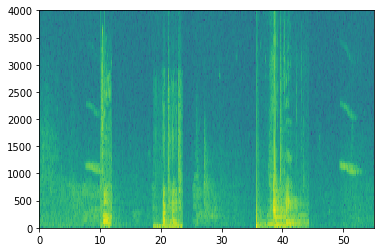

In [6]:
x = graph_spectrogram("audio_examples/example_train.wav")
rate_temp, data = wavfile.read("audio_examples/example_train.wav")
print("Time steps in audio recording before spectrogram", data[:,0].shape)
print("Time steps in input after spectrogram", x.shape)

#### Here wav file gives data in 2 channel format. Both coloumns of data have same values


In [7]:

rate_check, data_check = wavfile.read("audio_examples/example_train.wav")
print (rate_check)
print (data_check.shape)
print (np.sum(data_check[:,0]-data_check[:,1]))


44100
(441000, 2)
0


In [8]:
Tx = 5511 # The number of time steps input to the model from the spectrogram
n_freq = 101 # Number of frequencies input to the model at each time step of the spectrogram

In [9]:
Ty = 1375 # The number of time steps in the output of our model

### # Load audio segments using pydub 


In [10]:
def load_raw_audio():
    activates = []
    backgrounds = []
    negatives = []
    for filename in os.listdir("./raw_data/activates"):
        if filename.endswith("wav"):
            activate = AudioSegment.from_wav("./raw_data/activates/"+filename)
            activates.append(activate)
    for filename in os.listdir("./raw_data/backgrounds"):
        if filename.endswith("wav"):
            background = AudioSegment.from_wav("./raw_data/backgrounds/"+filename)
            backgrounds.append(background)
    for filename in os.listdir("./raw_data/negatives"):
        if filename.endswith("wav"):
            negative = AudioSegment.from_wav("./raw_data/negatives/"+filename)
            negatives.append(negative)
    return activates, negatives, backgrounds

In [11]:
activates, negatives, backgrounds = load_raw_audio()

# above list has pydub objects. sample rate has been changed to 1Khz. 

print("background len: " + str(len(backgrounds[0])))    # Should be 10,000, since it is a 10 sec clip
print("activate[0] len: " + str(len(activates[0])))     # Maybe around 1000, since an "activate" audio clip is usually around 1 sec (but varies a lot)
print("activate[1] len: " + str(len(activates[1])))     # Different "activate" clips can have different lengths 
print("activate[2] len: " + str(len(activates[2]))) 
print("activate[3] len: " + str(len(activates[3]))) 

print ('number of backgrounds: ' + str(len(backgrounds)))
print ('number of activates: ' + str(len(activates)))
print ('number of negatives: ' + str(len(negatives)))

background len: 10000
activate[0] len: 1741
activate[1] len: 731
activate[2] len: 2392
activate[3] len: 1579
number of backgrounds: 2
number of activates: 10
number of negatives: 10


In [12]:
activates[0];

#### When you read via wavfile.read, you read actual data. sample rate = 44.1khz here. 
#### When you read via AudioSegment.from_wav, data is implicitly converted into millisecond format. Or sample rate= 1Khz

#### In raw_data directory, there are 2 files for backgrounds, 10 for activates, 10 for negatives

In [13]:
def get_random_time_segment(segment_ms):
    segment_start = np.random.randint(low=0, high=10000-segment_ms)   # Make sure segment doesn't run past the 10sec background 
    segment_end = segment_start + segment_ms - 1
    return (segment_start, segment_end)

In [14]:
def is_overlapping(segment_time, previous_segments):
    segment_start, segment_end = segment_time
    overlap = False
    for previous_start, previous_end in previous_segments:
        if segment_start <= previous_end and segment_end >= previous_start:
            overlap = True
    return overlap

In [15]:
def insert_audio_clip(background, audio_clip, previous_segments):
    segment_ms = len(audio_clip)
    segment_time = get_random_time_segment(segment_ms)
    while is_overlapping(segment_time, previous_segments):
        segment_time = get_random_time_segment(segment_ms)
    previous_segments.append(segment_time)
    new_background = background.overlay(audio_clip, position = segment_time[0])  # inbuilt pydub function
    return new_background, segment_time

In [16]:
audio_clip, segment_time = insert_audio_clip(backgrounds[0], activates[0], [(3790, 4400)])
audio_clip.export("insert_test.wav", format="wav")
print("Segment Time: ", segment_time)
IPython.display.Audio("insert_test.wav")

Segment Time:  (5989, 7729)


In [17]:
def insert_ones(y, segment_end_ms):
    segment_end_y = int(segment_end_ms * Ty / 10000.0)
    for i in range(segment_end_y + 1, segment_end_y + 51):
        if i < Ty:
            y[0, i] = 1
    return y

sanity checks: 0.0 1.0 0.0


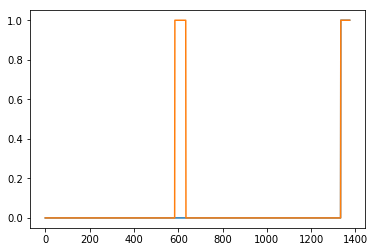

In [18]:
arr1 = insert_ones(np.zeros((1, Ty)), 9700)
plt.plot(arr1[0,:])
arr1=insert_ones(arr1, 4251)
plt.plot(arr1[0,:])
print("sanity checks:", arr1[0][1333], arr1[0][634], arr1[0][635])

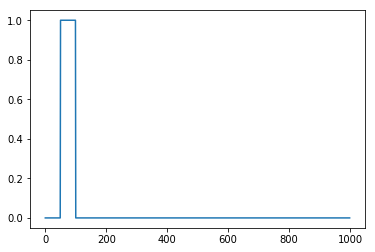

In [19]:
y=np.zeros(1000)
y[50:100]=1
plt.plot(y)

In [20]:
def create_training_example(background, activates, negatives):
    np.random.seed(18)
    background=background-20
    y=np.zeros((1,Ty))
    previous_segments = []
    number_of_activates = np.random.randint(0, 5)
    random_indices = np.random.randint(len(activates), size=number_of_activates)
    for index in random_indices:
        audio_clip=activates[index]
        segment_ms=len(audio_clip)
        background,segment_time=insert_audio_clip(background, audio_clip, previous_segments)
        y=insert_ones(y, segment_time[1])
    number_of_negatives = np.random.randint(0, 3)
    random_indices = np.random.randint(len(negatives), size=number_of_negatives)
    for index in random_indices:
        audio_clip=negatives[index]
        segment_ms=len(audio_clip)
        background,_=insert_audio_clip(background, audio_clip, previous_segments)
    background = match_target_amplitude(background, -20.0) # Standardize the volume of the audio clip 
    file_handle = background.export("train" + ".wav", format="wav") # Export new training example 
    print("File (train.wav) was saved in your directory.")
    x = graph_spectrogram("train.wav")
    return x, y

File (train.wav) was saved in your directory.
(101, 5511)
(1, 1375)


/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_axes.py:7564: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


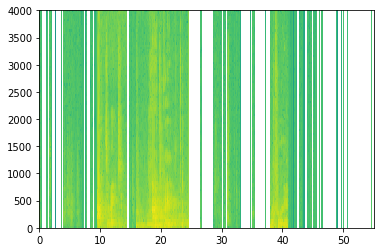

In [21]:
x, y = create_training_example(backgrounds[0], activates, negatives)
print (x.shape)
print (y.shape)

In [22]:
IPython.display.Audio("train.wav")

In [23]:
IPython.display.Audio("audio_examples/train_reference.wav")

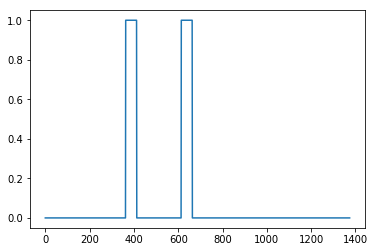

In [24]:
plt.plot(y[0])

In [26]:
# Load preprocessed training examples
X = np.load("./XY_train/X.npy")
Y = np.load("./XY_train/Y.npy")

In [27]:
X.shape

(26, 5511, 101)

In [28]:
Y.shape

(26, 1375, 1)

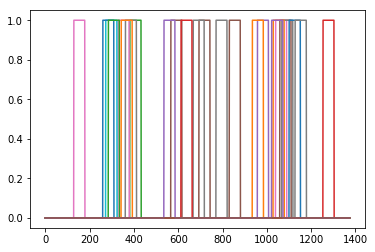

In [29]:
for i in range(26):
    #plt.figure()
    plt.plot(Y[i][:,0])

In [30]:
print (X.shape)
print (Y.shape)

(26, 5511, 101)
(26, 1375, 1)


In [31]:
# Load preprocessed dev set examples
X_dev = np.load("./XY_dev/X_dev.npy")
Y_dev = np.load("./XY_dev/Y_dev.npy")

In [32]:
print (X_dev.shape)
print (Y_dev.shape)

(25, 5511, 101)
(25, 1375, 1)


In [33]:
from keras.callbacks import ModelCheckpoint
from keras.models import Model, load_model, Sequential
from keras.layers import Dense, Activation, Dropout, Input, Masking, TimeDistributed, LSTM, Conv1D
from keras.layers import GRU, Bidirectional, BatchNormalization, Reshape
from keras.optimizers import Adam
import keras
print("keras version :",keras.__version__)

keras version : 2.2.2


Using TensorFlow backend.


In [34]:
print ("input_shape :", Tx,',',n_freq)

input_shape : 5511 , 101


In [35]:
def model(input_shape):    
    X_input = Input(shape = input_shape)
    
    X = Conv1D(196, kernel_size=15, strides=4)(X_input)                                 
    X = BatchNormalization()(X)                                 
    X = Activation('relu')(X)                                  
    X = Dropout(0.8)(X)        
    
    X = GRU(units = 128, return_sequences = True)(X)     
    X = Dropout(0.8)(X)                                   
    X = BatchNormalization()(X)    # note: no dropout here
    
    X = GRU(units = 128, return_sequences = True)(X)                                  
    X = Dropout(0.8)(X)                                   
    X = BatchNormalization()(X)                                  
    X = Dropout(0.8)(X)     
    
    X = TimeDistributed(Dense(1, activation = "sigmoid"))(X) # time distributed  (sigmoid)
    model = Model(inputs = X_input, outputs = X)
    
    return model  

In [36]:
model = model(input_shape = (Tx, n_freq))

In [37]:
(model.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 5511, 101)         0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 1375, 196)         297136    
_________________________________________________________________
batch_normalization_1 (Batch (None, 1375, 196)         784       
_________________________________________________________________
activation_1 (Activation)    (None, 1375, 196)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 1375, 196)         0         
_________________________________________________________________
gru_1 (GRU)                  (None, 1375, 128)         124800    
_________________________________________________________________
dropout_2 (Dropout)          (None, 1375, 128)         0         
__________

In [38]:
GRU_layer=model.layers[5]
(GRU_layer.get_weights()[0].shape)

(196, 384)

In [39]:
GRU_layer=model.layers[5]
print (GRU_layer.kernel)
print (GRU_layer.kernel_h)
print (GRU_layer.kernel_z)
print (GRU_layer.kernel_r)
print (GRU_layer.recurrent_kernel)
print (GRU_layer.bias)

AttributeError: 'GRU' object has no attribute 'kernel'

In [40]:
gru=model.get_layer('gru_1')
print(gru.weights)
print (gru.kernel.shape)
print (gru.recurrent_kernel.shape)
print(gru.bias.shape)

[<tf.Variable 'gru_1/kernel:0' shape=(196, 384) dtype=float32_ref>, <tf.Variable 'gru_1/recurrent_kernel:0' shape=(128, 384) dtype=float32_ref>, <tf.Variable 'gru_1/bias:0' shape=(384,) dtype=float32_ref>]


AttributeError: 'GRU' object has no attribute 'kernel'

In [43]:
model = load_model('./models/tr_model.h5')

/anaconda3/lib/python3.6/site-packages/keras/engine/saving.py:304: UserWarning: Error in loading the saved optimizer state. As a result, your model is starting with a freshly initialized optimizer.
  warnings.warn('Error in loading the saved optimizer '


In [44]:
opt = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, decay=0.01)
model.compile(loss='binary_crossentropy', optimizer=opt, metrics=["accuracy"])

In [45]:
model.fit(X, Y, batch_size = 5, epochs=1)

Epoch 1/1
26/26 [==============================] - 25s 947ms/step - loss: 0.0675 - acc: 0.9783


In [46]:
loss, acc = model.evaluate(X_dev, Y_dev)
print("Dev set accuracy = ", acc)

25/25 [==============================] - 4s 142ms/step
Dev set accuracy =  0.9234617948532104


## Viz the accuracy on dev set

In [47]:
y_pred=model.predict(X_dev)

In [48]:
print (y_pred.shape)

(25, 1375, 1)


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


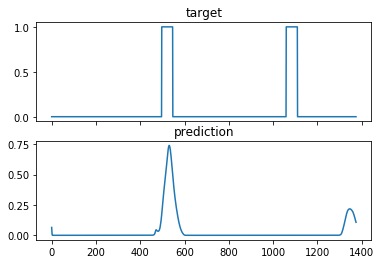

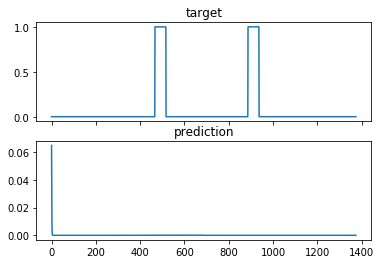

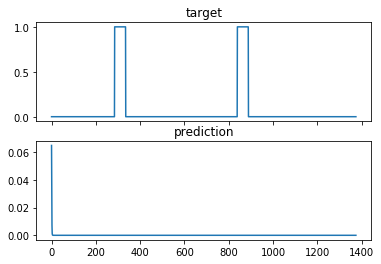

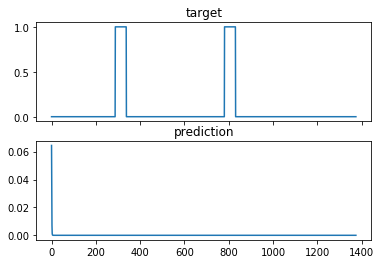

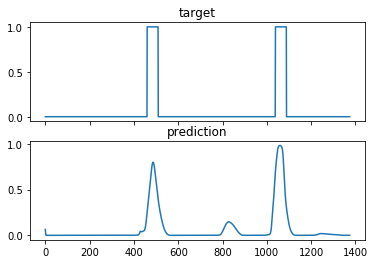

...

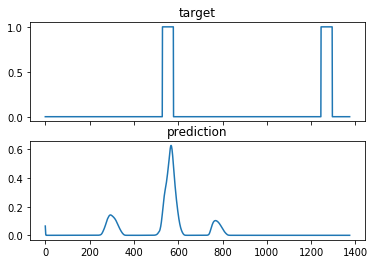

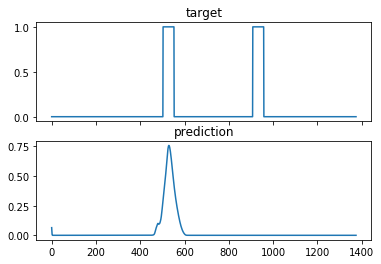

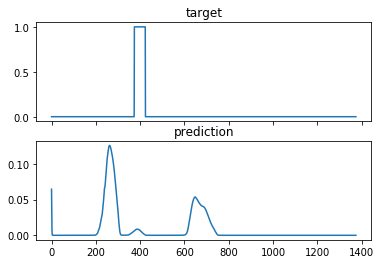

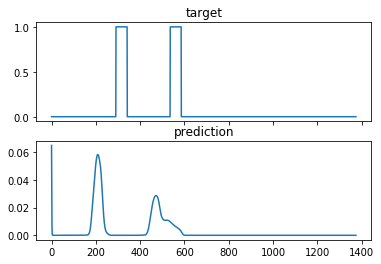

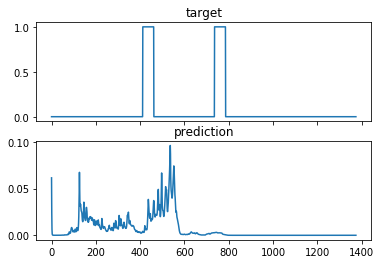

In [188]:
for i in range(25):
    f, axarr = plt.subplots(2, sharex=True);
    axarr[0].plot(Y_dev[i][:,0]);
    axarr[0].set_title('target');
    axarr[1].plot(y_pred[i][:,0]);
    axarr[1].set_title('prediction');


In [194]:
def detect_triggerword(filename):
    plt.subplot(2, 1, 1)

    x = graph_spectrogram(filename)
    # the spectogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model.predict(x)
    
    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    return predictions

In [195]:
chime_file = "audio_examples/chime.wav"
def chime_on_activate(filename, predictions, threshold):
    audio_clip = AudioSegment.from_wav(filename)
    chime = AudioSegment.from_wav(chime_file)
    Ty = predictions.shape[1]
    # Step 1: Initialize the number of consecutive output steps to 0
    consecutive_timesteps = 0
    # Step 2: Loop over the output steps in the y
    for i in range(Ty):
        # Step 3: Increment consecutive output steps
        consecutive_timesteps += 1
        # Step 4: If prediction is higher than the threshold and more than 75 consecutive output steps have passed
        if predictions[0,i,0] > threshold and consecutive_timesteps > 75:
            # Step 5: Superpose audio and background using pydub
            audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio_clip.duration_seconds)*1000)
            # Step 6: Reset consecutive output steps to 0
            consecutive_timesteps = 0
        
    audio_clip.export("chime_output.wav", format='wav')

In [196]:
IPython.display.Audio("./raw_data/dev/1.wav")

In [197]:
IPython.display.Audio("./raw_data/dev/2.wav")

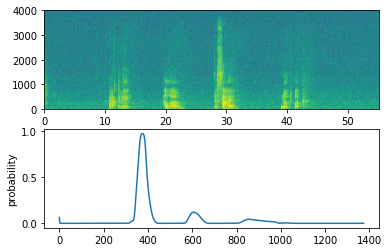

In [198]:
filename = "./raw_data/dev/1.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

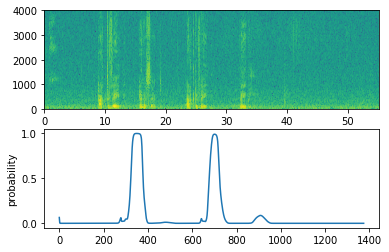

In [199]:
filename  = "./raw_data/dev/2.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

# custom file

In [200]:
# Preprocess the audio to the correct format
def preprocess_audio(filename):
    # Trim or pad audio segment to 10000ms
    padding = AudioSegment.silent(duration=10000)
    segment = AudioSegment.from_wav(filename)[:10000]
    segment = padding.overlay(segment)
    # Set frame rate to 44100
    segment = segment.set_frame_rate(44100)
    # Export as wav
    segment.export(filename, format='wav')

In [201]:
your_filename = "audio_examples/my_audio.wav"
preprocess_audio(your_filename)
IPython.display.Audio(your_filename) # listen to the audio you uploaded 

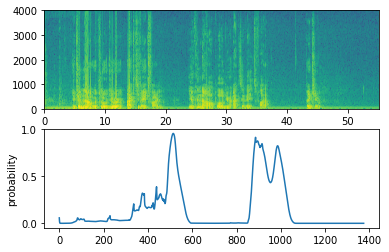

In [202]:
chime_threshold = 0
prediction = detect_triggerword(your_filename)
chime_on_activate(your_filename, prediction, chime_threshold)
IPython.display.Audio("./chime_output.wav")